In [26]:
import os

import torch
import torch_geometric as pyg
from tqdm.notebook import tqdm

import dataset
import model
import rollout
import visualize

In [27]:
# sample config
config = {
    "data_path": "datasets/MultiMaterial",
    "epoch": 1,                             
    "batch_size": 2,                        
    "lr": 1e-3,                             
    "num_workers": 0,                       
    "noise": 3e-4,                  
    "eval_interval": 100,            
    "rollout_interval": 100,  
    "vis_interval": 1000000,             
    "save_interval": 1000000,            
    "output_path": "output",      
}

In [28]:
# load onestep datasets
train_dataset = dataset.OneStepDataset(
    config["data_path"], "train", noise_std=config["noise"]
)[:2]
valid_dataset = dataset.OneStepDataset(
    config["data_path"], "valid", noise_std=config["noise"]
)[:2]
print(train_dataset[0])
print(valid_dataset[0])

FileNotFoundError: [Errno 2] No such file or directory: 'datasets/MultiMaterial/metadata.json'

In [ ]:
# setup dataloaders
train_loader = pyg.loader.DataLoader(
    train_dataset,
    batch_size=config["batch_size"],
    shuffle=True,
    pin_memory=False, # only beneficial when training on GPU
    num_workers=config["num_workers"],
)
valid_loader = pyg.loader.DataLoader(
    valid_dataset,
    batch_size=config["batch_size"],
    shuffle=False,
    pin_memory=False, # only beneficial when training on GPU
    num_workers=config["num_workers"],
)
for x in train_loader:
    print(x)
    break
for x in valid_loader:
    print(x)
    break

DataBatch(x=[5606], edge_index=[2, 52320], edge_attr=[52320, 3], y=[5606, 2], pos=[5606, 14], batch=[5606], ptr=[3])
DataBatch(x=[3470], edge_index=[2, 30992], edge_attr=[30992, 3], y=[3470, 2], pos=[3470, 14], batch=[3470], ptr=[3])


In [ ]:
# load rollout dataset
rollout_dataset = dataset.RolloutDataset(config["data_path"], "valid")[:2]
rollout_dataset[0].keys()
for k,v in rollout_dataset[0].items():
    print(k, v.shape, v.dtype)

particle_type torch.Size([1735]) torch.int64
position torch.Size([401, 1735, 2]) torch.float32


In [ ]:
# visualize example rollout

%matplotlib inline
import matplotlib.pyplot as plt
from visualize import visualize_single
from IPython.display import HTML

plt.ioff()
ani = visualize_single(rollout_dataset[0]["particle_type"], rollout_dataset[0]["position"], rollout_dataset.metadata)
HTML(ani.to_jshtml())

In [ ]:
# init model
simulator = model.LearnedSimulator(   
    hidden_size=32,
    n_mp_layers=2
)
simulator

LearnedSimulator(
  (embed_type): Embedding(9, 16)
  (node_in): MLP(
    (layers): ModuleList(
      (0): Linear(in_features=30, out_features=32, bias=True)
      (1): ReLU()
      (2): Linear(in_features=32, out_features=32, bias=True)
      (3): ReLU()
      (4): Linear(in_features=32, out_features=32, bias=True)
      (5): LayerNorm((32,), eps=1e-05, elementwise_affine=True)
    )
  )
  (edge_in): MLP(
    (layers): ModuleList(
      (0): Linear(in_features=3, out_features=32, bias=True)
      (1): ReLU()
      (2): Linear(in_features=32, out_features=32, bias=True)
      (3): ReLU()
      (4): Linear(in_features=32, out_features=32, bias=True)
      (5): LayerNorm((32,), eps=1e-05, elementwise_affine=True)
    )
  )
  (node_out): MLP(
    (layers): ModuleList(
      (0): Linear(in_features=32, out_features=32, bias=True)
      (1): ReLU()
      (2): Linear(in_features=32, out_features=32, bias=True)
      (3): ReLU()
      (4): Linear(in_features=32, out_features=2, bias=True)
    

In [ ]:
from train import train

# train loop
train_loss_list, eval_loss_list, onestep_mse_list, rollout_mse_list = train(config, simulator, train_loader, valid_loader, rollout_dataset, rollout_dataset.metadata)

Epoch 0: 100%|██████████| 1/1 [00:00<00:00,  3.48it/s, loss=1.58, avg_loss=1.58, lr=0.001]


<Figure size 500x500 with 0 Axes>

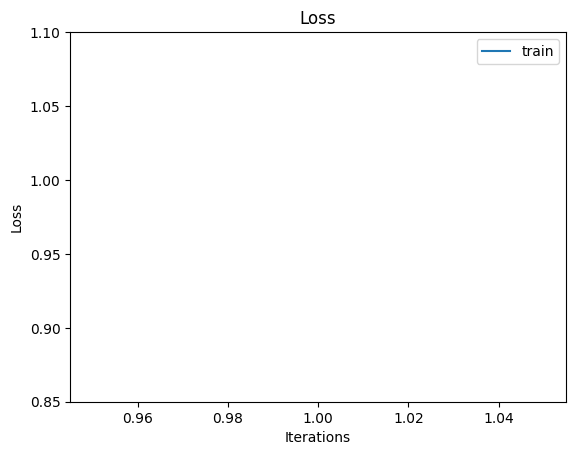

In [ ]:
# plot loss
plt.clf()
plt.figure()
plt.plot(*zip(*train_loss_list), label="train")
plt.plot(*zip(*eval_loss_list), label="valid")
plt.ylim(bottom=0.85, top=1.1)
plt.xlabel('Iterations')
plt.ylabel('Loss')
plt.title('Loss')
plt.legend()
plt.show()

/var/folders/m_/kvw9qz1x1f55wb_zplrp4k_m0000gn/T/ipykernel_82206/1414283775.py:8: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


<Figure size 640x480 with 0 Axes>

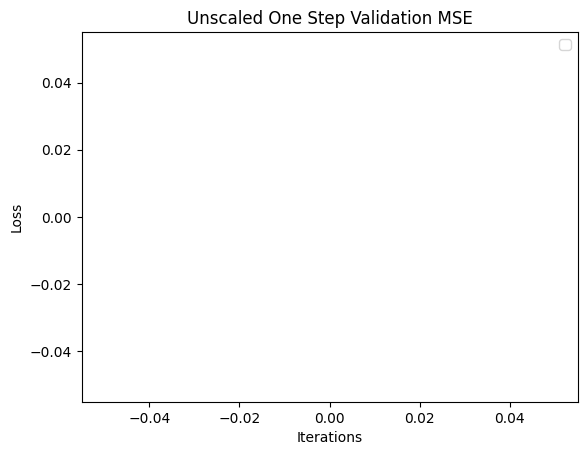

In [ ]:
# plot oneStepMSE
plt.clf()
plt.figure()
plt.plot(*zip(*onestep_mse_list), label="train")
plt.xlabel('Iterations')
plt.ylabel('Loss')
plt.title('Unscaled One Step Validation MSE')
plt.legend()
plt.show()

/var/folders/m_/kvw9qz1x1f55wb_zplrp4k_m0000gn/T/ipykernel_82206/1706498207.py:8: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


<Figure size 640x480 with 0 Axes>

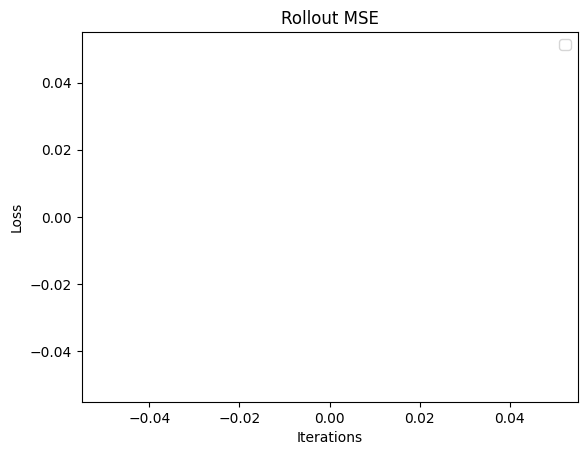

In [ ]:
# plot rolloutMSE
plt.clf()
plt.figure()
plt.plot(*zip(*rollout_mse_list), label="train")
plt.xlabel('Iterations')
plt.ylabel('Loss')
plt.title('Rollout MSE')
plt.legend()
plt.show()

In [ ]:
# visualize rollout
from visualize import visualize_pair

simulator.eval()
rollout_data = rollout_dataset[0]
rollout_out = rollout.rollout(simulator, rollout_data, rollout_dataset.metadata, config["noise"])
rollout_out = rollout_out.permute(1, 0, 2)
plt.clf()
ani = visualize.visualize_pair(rollout_data["particle_type"], rollout_out, rollout_data["position"], rollout_dataset.metadata)
HTML(ani.to_jshtml())

In [ ]:
rollout_data["particle_type"]

tensor([3, 3, 3,  ..., 6, 6, 6])